In [1]:
#!pip install librosa
#!pip install matplotlib
#!pip install split-folders
#!pip install skimage
#!pip install scikit-image
#!pip install seaborn
#!pip install pandas
#!pip install seaborn
import matplotlib.pyplot as plt
import numpy as np 
import librosa as librosa
import librosa.display

In [2]:
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
%matplotlib inline
import librosa.display
import IPython.display as ipd
from IPython.display import Audio
import os
from sklearn.model_selection import train_test_split
import splitfolders
import skimage.io
from IPython import display

In [3]:
import seaborn as sns

In [4]:
import pandas as pd

In [5]:
audio_data1 = 'input/Audio_one_person.ogg'

In [6]:
audio_data2 = 'input/Audio.ogg'

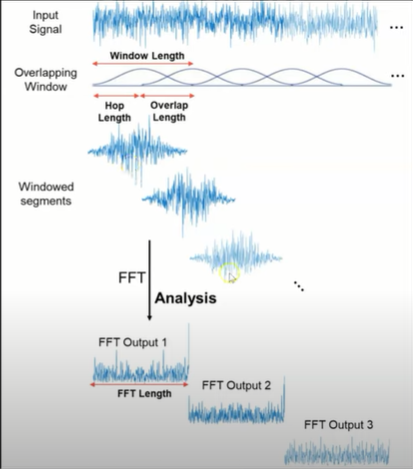

In [7]:
url = ('Chema.png')
display.Image(url)

In [26]:
y, sr = librosa.load(audio_data2)


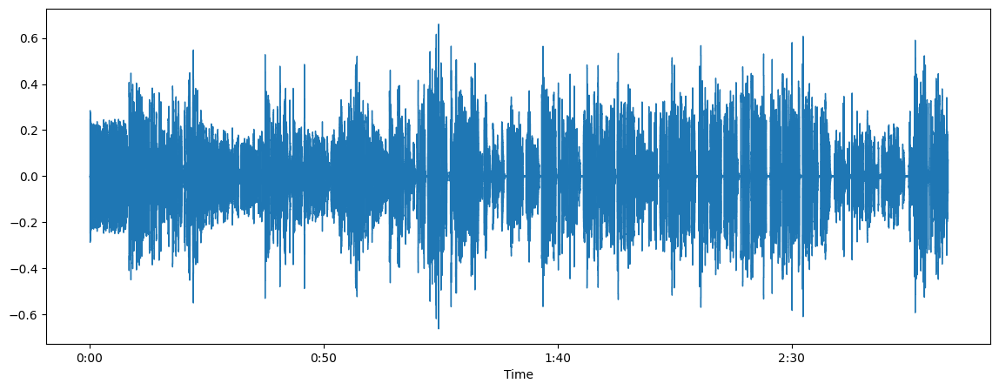

In [9]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y, sr=sr)
ipd.Audio(audio_data2)

In [10]:
y

array([-1.2524645e-13, -1.4885956e-13, -1.5521514e-13, ...,
        1.2433869e-02,  1.2470819e-02, -2.0617727e-02], dtype=float32)

In [11]:
sr

22050

In [12]:
n_fft=2048
hop_length=512
n_mfcc = 20

In [13]:
audio2_duration = librosa.get_duration(y=y, sr=sr,S=None,n_fft=2048,hop_length=512,center=True,filename=audio_data2)

C:\Users\MiGames\AppData\Local\Temp\ipykernel_26996\2217936739.py:1: FutureWarning: get_duration() keyword argument 'filename' has been renamed to 'path' in version 0.10.0.
	This alias will be removed in version 1.0.
  audio2_duration = librosa.get_duration(y=y, sr=sr,S=None,n_fft=2048,hop_length=512,center=True,filename=audio_data2)


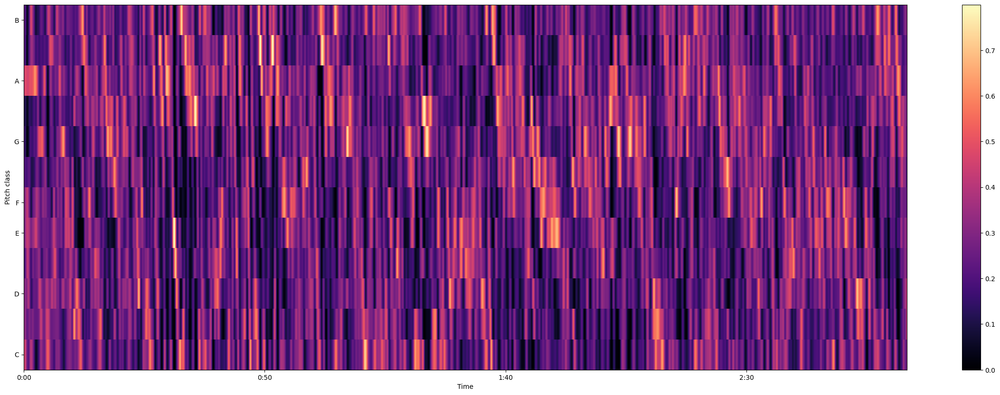

In [14]:
#Chroma Energy Normalized (CENS)
chroma=librosa.feature.chroma_cens(y=y, sr=sr)
plt.figure(figsize=(30, 10))
librosa.display.specshow(chroma,y_axis='chroma', x_axis='time')
plt.colorbar()

In [28]:
yt, index = librosa.effects.trim(y)


In [27]:
y

array([-1.2524645e-13, -1.4885956e-13, -1.5521514e-13, ...,
        1.2433869e-02,  1.2470819e-02, -2.0617727e-02], dtype=float32)

In [30]:
print(librosa.effects.trim(y))

(array([ 5.2992299e-08,  1.9937072e-08, -2.7138813e-07, ...,
        1.4126898e-02,  1.0909250e-02,  0.0000000e+00], dtype=float32), array([    512, 4042077]))


In [179]:
mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, hop_length=hop_length).T
mfcc

array([[-588.7192   ,    0.       ,    0.       , ...,    0.       ,
           0.       ,    0.       ],
       [-296.28873  ,   62.428688 ,    4.4875326, ...,    0.7805055,
         -12.238707 ,   -7.128231 ],
       [-106.28506  ,   64.513535 ,    7.038724 , ...,   -2.914627 ,
          -7.602069 ,   -5.2838073],
       ...,
       [-250.68877  ,  -15.461582 ,   70.07555  , ...,    5.113591 ,
          -9.152604 ,   -1.6113781],
       [-265.68802  ,  -53.637993 ,   39.320488 , ...,    1.5280998,
         -10.394985 ,   -2.17237  ],
       [-276.98965  ,  -55.095306 ,   21.927109 , ...,    6.416475 ,
          -7.7467346,   -5.518709 ]], dtype=float32)

# Chroma Energy Normalized (CENS)

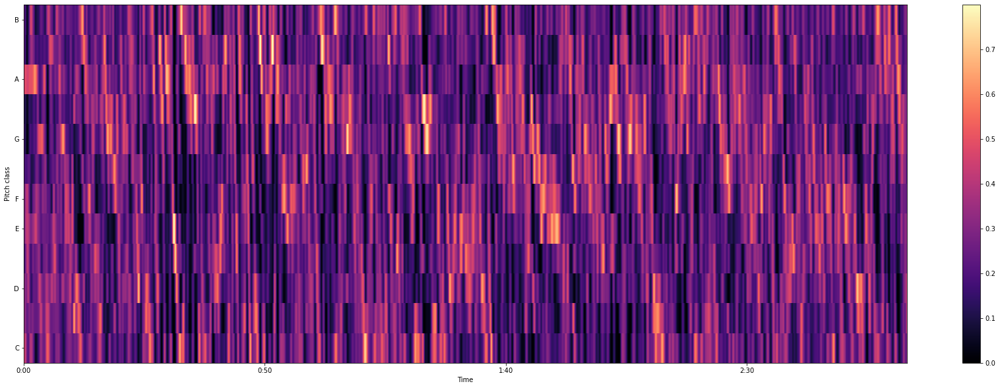

In [32]:

chroma=librosa.feature.chroma_cens(y=yt, sr=sr)
plt.figure(figsize=(30, 10))
librosa.display.specshow(chroma,y_axis='chroma', x_axis='time')
plt.colorbar()

In [36]:
from sklearn.cluster import KMeans
import mir_eval

# search start speak

In [173]:
onset_frames = librosa.onset.onset_detect(y=y, sr=sr, delta=0.04, wait=4)
onset_times = librosa.frames_to_time(onset_frames, sr=sr)
onset_samples = librosa.frames_to_samples(onset_frames)
onset_samples

array([   1536,    8704,   17408,   22016,   28672,   35840,   38400,
         43008,   45568,   48640,   51712,   55296,   60416,   66048,
         70656,   75776,   81408,   84992,   92160,   99840,  106496,
        117248,  121344,  139264,  144896,  147456,  158208,  176128,
        185344,  190976,  194048,  197632,  202752,  205312,  209408,
        214016,  216576,  220160,  224768,  233472,  236544,  240128,
        243200,  246272,  248832,  252928,  256512,  260608,  263680,
        273408,  286208,  289280,  293888,  297984,  303104,  306688,
        312832,  316416,  320000,  323584,  326144,  330240,  335360,
        337920,  342016,  348672,  351232,  356864,  360448,  366080,
        369152,  374272,  378880,  384512,  390144,  394752,  398336,
        402432,  406016,  414208,  422400,  427520,  430080,  432640,
        437248,  441344,  446464,  452608,  458752,  461312,  465408,
        467968,  471040,  475136,  481280,  483840,  492544,  497152,
        503296,  506

In [148]:
y_with_beeps = mir_eval.sonify.clicks(onset_times, sr, length=len(y))
ipd.Audio (y+ y_with_beeps, rate=sr)

## Feature Extraction

In [139]:
# def extract_features(y, sr, n_mfcc=n_mfcc, hop_length=512):
#     # Извлечение MFCC признаков из аудиофайла
#     mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, hop_length=hop_length)
#     return mfcc.T

In [149]:
import scipy

In [156]:
def extract_features(y, sr):
    zcr = librosa.zero_crossings(y).sum()
    energy = scipy.linalg.norm(y)
    return [zcr, energy]

In [174]:
frame_sz = [sr * 0.090]
frame_sz

[1984.5]

In [177]:
# frame_sz = [sr * 0.090]
features = numpy.array([extract_features(y[i:i+frame_sz], fs) for i in onset_samples])
features.shape

TypeError: only integer scalar arrays can be converted to a scalar index

In [153]:
# mfcc.T

In [93]:
# ftest = [(y[i:i+frame_sz], sr) for i in onset_samples]
# ftest

In [99]:
import sklearn

## Feature Scaling

In [132]:
min_max_scaler = sklearn.preprocessing.MinMaxScaler(feature_range=(-1, 1))
features_scaled = min_max_scaler.fit_transform(features)
features_scaled.shape
features_scaled.min(axis=0)
features_scaled.max(axis=0)

array([-1., -1.])

Text(0, 0.5, 'Spectral Centroid (scaled)')

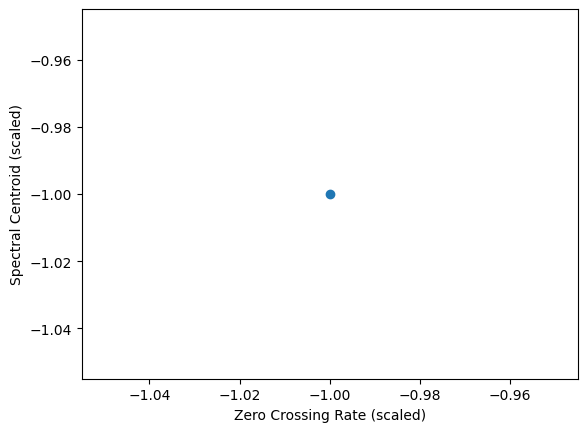

In [133]:
plt.scatter(features_scaled[:,0], features_scaled[:,1])
plt.xlabel('Zero Crossing Rate (scaled)')
plt.ylabel('Spectral Centroid (scaled)')

In [94]:
plt.scatter(features_scaled[:,0], features_scaled[:,1])
plt.xlabel('Zero Crossing Rate (scaled)')
plt.ylabel('Spectral Centroid (scaled)')

NameError: name 'features_scaled' is not defined

In [92]:
# features = np.array([extract_features(y[i:i+frame_sz], sr) for i in onset_samples])
# features
# features.shape